# SpatialMouse - Measure gene expression and cell type proportion as function of vessel distance - Kidney

## Background

In `SpatialMouse_09b` I localized the vessels in two Kidney sections by identifying nuclei with a certain amount of phalloidin and CD31 signal.

## Goal

1. Measure distance of vessels to each spot.
2. Show gene expression as function of vessel distance.
3. Identify genes that correlate with the vessel distance.

In [2]:
## The following code ensures that all functions and init files are reloaded before executions.
%load_ext autoreload
%autoreload 2

In [3]:
# set home directory
HOME = "/home/hpc/johannes.wirth"

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
import pandas as pd
import anndata
import seaborn as sns
from tqdm import tqdm
from glob import glob
import squidpy as sq
import gc
import cv2
from pathlib import Path
#import sfaira

## Import the custom library
import os
import sys
module_path = os.path.abspath(os.path.join(HOME, 'projects/xDbit_toolbox/'))
#module_path = os.path.abspath(os.path.join("/lustre/groups/hpc/meier_lab/projects/git/DbitX_toolbox/"))

if module_path not in sys.path:
    sys.path.append(module_path)

import xdbit_funcs as db

In [5]:
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

In [6]:
plt.rcParams['figure.dpi'] = 80
plt.style.use('default')

In [7]:
#base_dir = "/lustre/groups/hpc/meier_lab/projects/SpatialMouse/"
#base_dir = "/lustre/home/hpc/johannes.wirth/data/experiments/SpatialMouse/"
base_dir = os.path.join(HOME, "data/experiments/SpatialMouse/")
#data_dir = os.path.join(base_dir, "analysis", "segmentation")
#img_dir = os.path.join(base_dir, "analysis", "images", "pseudoffc")

# Load data

## Load spatial Kidney data and extract the key that we are using here

Keys to use: `"37_46_C1"` and `"37_46_B3"`

In [8]:
adata_files = {
    "37_46_B3": "out/Kidney-37_46_B3-adata-cell2location.h5ad",
    "37_46_C1": "out/Kidney-37_46_C1-adata-cell2location.h5ad"
}

adatas = {i: sc.read(f) for i, f in adata_files.items()}

In [9]:
# remove all uns keys except for `spatial`
for i, adata in adatas.items():
    keys = list(adata.uns.keys())
    for k in keys:
        if k != "spatial":
            del adata.uns[k]

In [10]:
adata = anndata.concat(adatas, 
                       merge="unique", # to not lose .var
                       uns_merge="unique" # to not lose .uns
                      )

In [11]:
adata

AnnData object with n_obs × n_vars = 2236 × 6010
    obs: 'array_row', 'array_col', 'um_row', 'um_col', 'id', 'pixel_row', 'pixel_col', 'dapi_mean', 'dapi_mean_norm', 'experiment_id', 'organism', 'age', 'organ', 'age_months', 'mouse_id', 'exp_date', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'CT010467.1_pct', 'leiden_uncorrected', 'leiden', 'leiden_coarse', '_indices', '_scvi_batch', '_scvi_labels', 'Distal convoluted tubules', 'Early proximal tubules', 'Endothelial cells', 'Collecting duct intercalated cells', 'Loop of Henle', 'Macrophages', 'Nephron progenitors', 'Neutrophils', 'Collecting duct principal cells', 'Proximal convoluted tubules', 'Proximal straight tubules', 'Podocytes', 'Proliferating cells', 'Stromal cells 1', 'Stromal cells 2', 'Unnamed'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_inte

## Load regprops

In [12]:
proximity_dir = os.path.join(base_dir, "analysis/segmentation/features/proximity/*")
feature_files = glob(proximity_dir)

In [13]:
feature_files

['/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation/features/proximity/featureprops-37_46_B3-dapi.csv',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation/features/proximity/featureprops-37_46_B3-binary.csv',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation/features/proximity/featureprops-37_46_C1-bf.csv',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation/features/proximity/featureprops-37_46_C1-phalloidin.csv',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation/features/proximity/featureprops-37_46_C1-CD31.csv',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation/features/proximity/featureprops-37_46_C1-binary.csv',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation/features/proximity/featureprops-37_46_B3-CD31.csv',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentat

In [14]:
regprops = db.im.load_regprops(feature_files)

## Add nuclei information to adata

Added to `.uns['nuclei']`

In [15]:
adata.uns['nuclei'] = regprops

In [16]:
adata

AnnData object with n_obs × n_vars = 2236 × 6010
    obs: 'array_row', 'array_col', 'um_row', 'um_col', 'id', 'pixel_row', 'pixel_col', 'dapi_mean', 'dapi_mean_norm', 'experiment_id', 'organism', 'age', 'organ', 'age_months', 'mouse_id', 'exp_date', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'CT010467.1_pct', 'leiden_uncorrected', 'leiden', 'leiden_coarse', '_indices', '_scvi_batch', '_scvi_labels', 'Distal convoluted tubules', 'Early proximal tubules', 'Endothelial cells', 'Collecting duct intercalated cells', 'Loop of Henle', 'Macrophages', 'Nephron progenitors', 'Neutrophils', 'Collecting duct principal cells', 'Proximal convoluted tubules', 'Proximal straight tubules', 'Podocytes', 'Proliferating cells', 'Stromal cells 1', 'Stromal cells 2', 'Unnamed'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_inte

# Calculate distance of each spot to closest vessel

In [17]:
keys = regprops.keys()

dists_list = []
for key in keys:
    # get vessels
    binprops = adata.uns['nuclei'][key]['binary']
    vessels = binprops.loc[binprops['vessel'], :]

    # extract vessel coordinates
    ves_coord = vessels[["centroid-1", "centroid-0"]].values

    # extract spot coordinates from adata
    spot_coord = adata.obs.query('id == "{}"'.format(key))[['pixel_col', 'pixel_row']].values

    # get scalefactor for transformation into µm
    ppu = adata.uns['spatial']['{}-dapi'.format(key)]['scalefactors']['pixel_per_um']

    # calculate min dist for each spot and add to adata
    dists = np.array([np.min([np.linalg.norm(s - c) for c in ves_coord]) for s in spot_coord]) / ppu
    # convert to series and add index
    dists = pd.Series(dists)
    dists.index = adata.obs.query('id == "{}"'.format(key)).index
    dists_list.append(dists)
    
# add distances to adata
adata.obs['vessel_dist'] = pd.concat(dists_list)

In [18]:
target_genes = ['Actb', 'Cyp2e1', 'Pck1']

Saving figure to file figures/vesseldist/lineplot-example-genes.pdf
Saved.


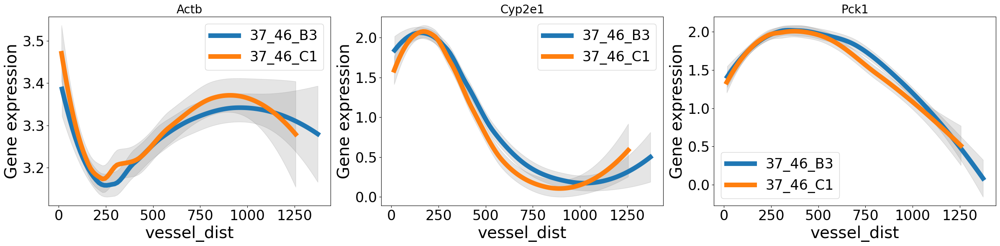

In [19]:
db.pl.expr_along_obs_val(adata, keys=target_genes, x_category='vessel_dist', groupby='id', method="loess", stderr=True, 
                         savepath="figures/vesseldist/lineplot-example-genes.pdf"
                        )

In [20]:
top_expressed = adata.var.sort_values('means', ascending=False).head(1000).index.values

In [21]:
reg = db.pl.expr_along_obs_val(adata, keys=top_expressed, x_category='vessel_dist', groupby='id', 
                         method="loess", stderr=True,
                         return_data=True, show_progress=True
                        )

100%|██████████| 1000/1000 [00:44<00:00, 22.48it/s]


In [22]:
mean = reg.groupby(['key', 'id']).mean()

## Compare this axis with a randomly generated axis?

In [23]:
adata.obs['vessel_dist_shuffled'] = adata.obs['vessel_dist'].sample(n=len(adata), random_state=2023).values

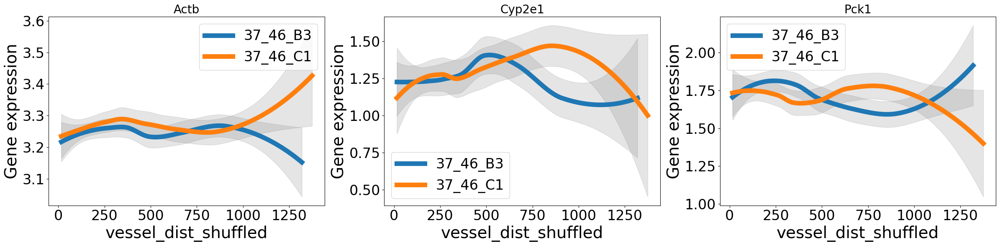

In [24]:
db.pl.expr_along_obs_val(adata, keys=target_genes, x_category='vessel_dist_shuffled', groupby='id', method="loess", stderr=True)

In [25]:
shuffled = db.pl.expr_along_obs_val(adata, keys=top_expressed, x_category='vessel_dist_shuffled', groupby='id', 
                         method="loess", stderr=True,
                         return_data=True, show_progress=True
                        )

100%|██████████| 1000/1000 [00:44<00:00, 22.57it/s]


In [26]:
shuffled_mean = shuffled.groupby(['key', 'id']).mean()

In [27]:
data = pd.concat({"reg": mean, "shuffled": shuffled_mean})

In [28]:
data = data.reset_index([0, 2])

In [29]:
data['std']

key
Kap        0.052048
Kap        0.052737
Malat1     0.016754
Malat1     0.016352
Zbtb20     0.016140
             ...   
Manba      0.050748
Cachd1     0.039668
Cachd1     0.050587
Gm45792    0.043905
Gm45792    0.054291
Name: std, Length: 4000, dtype: float64

<AxesSubplot:xlabel='id', ylabel='std'>

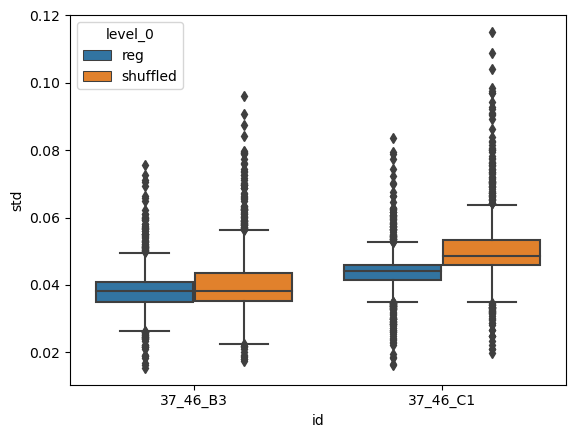

In [30]:
sns.boxplot(data=data, x='id', y='std', hue='level_0')

## Is this the right approach? Maybe it makes more sense to first do it for one gene and do the shuffling multiple times, calculate the mean STD for each shuffle and check where the unshuffled data lies compared to the shuffled "cloud"

In [31]:
d = db.pl.expr_along_obs_val(adata, keys="Cyp2e1", x_category='vessel_dist', groupby='id', 
                         method="loess", stderr=True,
                         return_data=True, show_progress=True
                        )

100%|██████████| 1/1 [00:00<00:00, 20.51it/s]


In [32]:
d.mean()["std"]

0.059916218913830456

In [33]:
shuffled_res = []

for r in tqdm(range(100)):
    adata.obs['vessel_dist_shuffled'] = adata.obs['vessel_dist'].sample(n=len(adata), random_state=r).values
    s = db.pl.expr_along_obs_val(adata, keys="Cyp2e1", x_category='vessel_dist_shuffled', groupby='id', 
                             method="loess", stderr=True,
                             return_data=True, show_progress=False
                            )
    shuffled_res.append(s.mean()["std"])

100%|██████████| 100/100 [00:05<00:00, 18.92it/s]


## Analysis was not plotted yet

## Alternative idea: Calculate Euclidean distance between the two sections and show that this is higher compared to randomly shuffled distances

In [245]:
reg_piv = reg[['y_pred']].reset_index(1).pivot(columns='id')

In [246]:
dists = []
genes = reg_piv.index.unique(level=0)
for g in tqdm(genes):
    dists.append(pdist(reg_piv.loc[g].T, metric='euclidean')[0])

dists = pd.DataFrame({'dists': dists}, index=genes)

100%|██████████| 1000/1000 [00:00<00:00, 2456.23it/s]


In [264]:
shuffled_res = []

for r in tqdm(range(100)):
    adata.obs['vessel_dist_shuffled'] = adata.obs['vessel_dist'].sample(n=len(adata), random_state=r).values
    s = db.pl.expr_along_obs_val(adata, keys='Cyp2e1', x_category='vessel_dist_shuffled', groupby='id', 
                             method="loess", stderr=True,
                             return_data=True, show_progress=False
                            )
    shuffled_res.append(s)

100%|██████████| 100/100 [00:04<00:00, 20.31it/s]


In [265]:
shufres = []
for res in tqdm(shuffled_res):
    piv = res[['y_pred']].reset_index(1).pivot(columns='id')
    
    d = []
    genes = piv.index.unique(level=0)
    for g in genes:
        d.append(pdist(piv.loc[g].T, metric='euclidean')[0])
    d = pd.DataFrame({'dists': d}, index=genes)
    shufres.append(d)

100%|██████████| 100/100 [00:00<00:00, 292.83it/s]


In [267]:
shufres = pd.concat(shufres, axis=1)

In [268]:
shufres.columns = range(shufres.shape[1])

In [269]:
shufres

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
key,,,,,,,,,,,,,,,,,,,,,
Cyp2e1,1.834331,1.018457,0.959464,0.800909,1.200766,1.002084,0.894457,0.832643,0.815277,1.514553,...,1.954555,1.651826,2.126776,1.034571,1.311406,1.127969,1.346404,1.207534,1.213585,1.662302


<AxesSubplot:ylabel='Cyp2e1'>

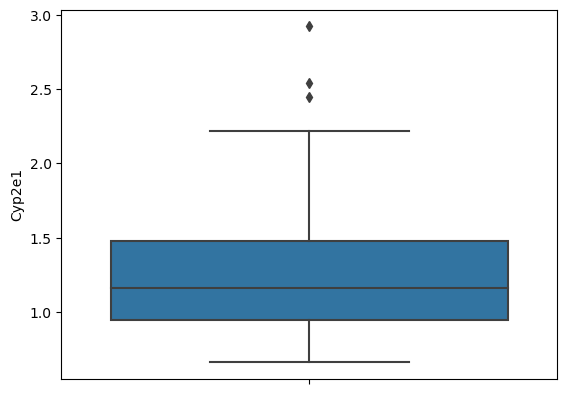

In [278]:
sns.boxplot(data=shufres.T, y='Cyp2e1')

In [274]:
dists.loc['Cyp2e1']

dists    0.712316
Name: Cyp2e1, dtype: float64

In [287]:
distdata = pd.DataFrame(pd.concat({'shuffled': shufres.T['Cyp2e1'], 'CCF': dists.loc['Cyp2e1']}, axis=0)).reset_index(0)

<AxesSubplot:ylabel='Cyp2e1'>

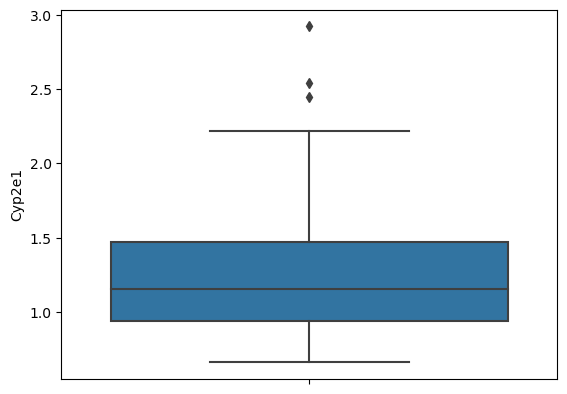

In [294]:
sns.boxplot(data=distdata, y='Cyp2e1', hue='level_0')

# Not sure how to plot this

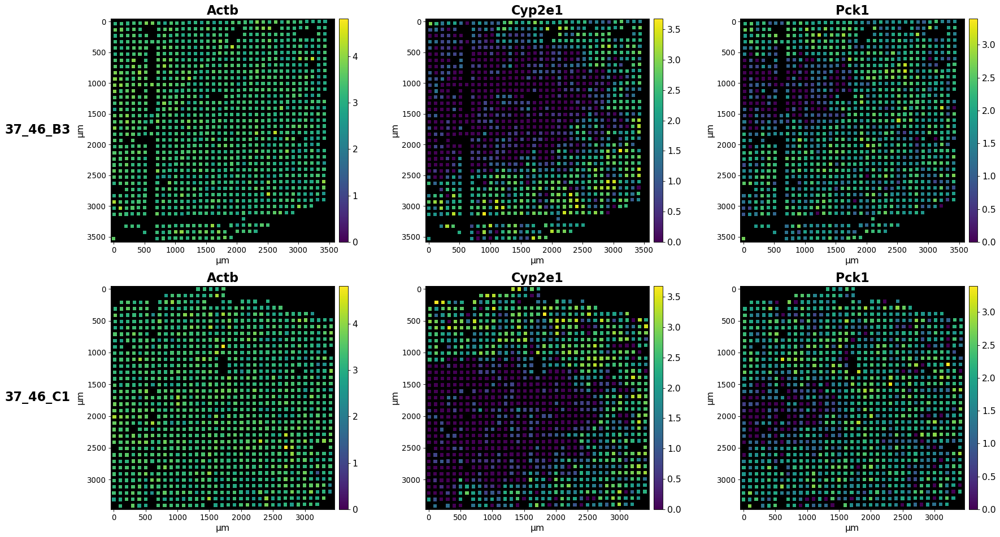

In [120]:
db.pl.spatial(adata, keys=target_genes, groupby='id')

Saving figure to file figures/vesseldist/spatial_vesseldist_dapi.pdf
Saved.


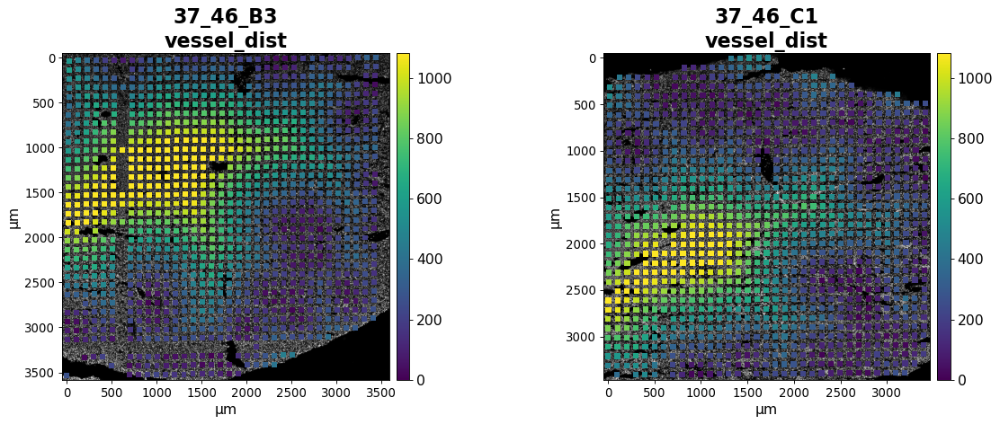

In [121]:
db.pl.spatial(adata, keys='vessel_dist', groupby='id', 
              image_key='dapi', 
              savepath="figures/vesseldist/spatial_vesseldist_dapi.pdf"
             )

Saving figure to file figures/vesseldist/spatial_vesseldist_dapi.pdf
Saved.


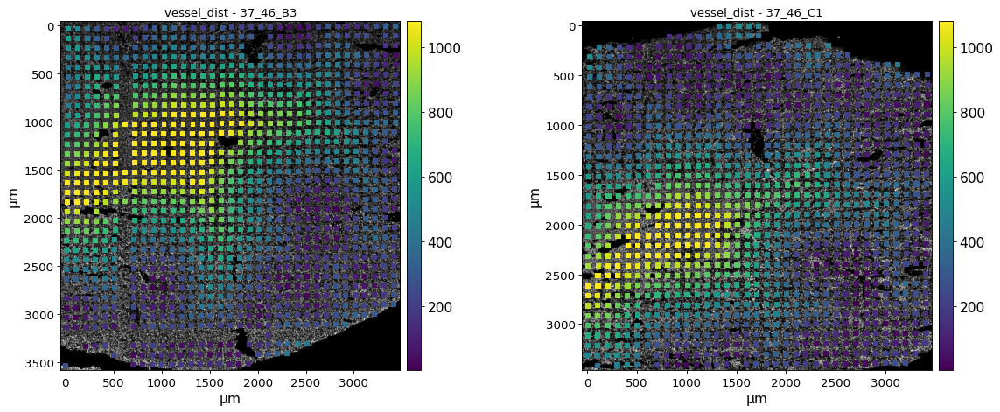

In [20]:
db.pl.spatial(adata, keys='vessel_dist', groupby='id', 
              image_key='dapi', 
              savepath="figures/vesseldist/spatial_vesseldist_dapi.pdf"
             )

## Cell type proportions depending on vesseldist

In [32]:
adata.obsm['q95_cell_abundance_w_sf']

,q95cell_abundance_w_sf_DCT,q95cell_abundance_w_sf_Early PT,q95cell_abundance_w_sf_Endo,q95cell_abundance_w_sf_IC,q95cell_abundance_w_sf_LOH,q95cell_abundance_w_sf_Macro,q95cell_abundance_w_sf_NP,q95cell_abundance_w_sf_Neutro,q95cell_abundance_w_sf_PC,q95cell_abundance_w_sf_PCT,q95cell_abundance_w_sf_PST,q95cell_abundance_w_sf_Podo,q95cell_abundance_w_sf_Proliferating,q95cell_abundance_w_sf_Stroma 1,q95cell_abundance_w_sf_Stroma 2,q95cell_abundance_w_sf_Unnamed
14x4-37_46_B3,0.297885,1.437265,3.278784,0.235080,1.910953,0.352784,1.016689,0.386716,0.253083,0.998059,13.019947,0.740772,0.684068,0.395158,1.151052,2.322379
14x3-37_46_B3,0.508291,0.867748,2.983296,0.212618,3.676920,0.842198,0.638709,0.331638,0.429101,0.350627,9.391096,0.684820,0.839503,0.105021,0.658177,1.776855
14x2-37_46_B3,0.347672,1.013061,3.408330,0.268970,2.040186,0.633773,1.943893,0.611993,0.370434,2.876516,7.027203,0.511728,0.454052,0.167548,0.728711,1.049657
14x1-37_46_B3,1.607603,1.924560,5.079881,0.110901,1.469260,0.520713,3.401615,0.626914,0.514705,4.957307,6.682704,0.557178,0.282128,0.294234,0.674576,0.963925
12x15-37_46_B3,0.702231,0.204746,4.911901,0.186822,8.416077,0.782967,1.026082,0.739276,1.160703,0.282665,0.303916,0.722843,1.156781,0.273176,1.439100,0.273845
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18x27-37_46_C1,0.428220,0.894948,4.058876,0.144516,4.080839,0.711360,0.703048,0.755774,0.448447,0.294703,9.534073,0.430351,0.900597,0.198732,0.883640,1.489678
18x22-37_46_C1,0.787744,0.466316,3.311696,0.230768,8.289505,0.909428,0.680165,0.540618,0.557103,0.229777,5.938038,0.467219,0.366355,0.285616,1.135641,0.864953
18x21-37_46_C1,0.345935,0.972050,3.447673,0.259469,3.319643,0.676019,0.923138,0.523662,0.518555,0.339158,11.157165,0.858920,1.042599,0.117984,0.914113,2.039681
18x24-37_46_C1,0.331087,0.422443,5.731601,0.162678,4.316017,1.239165,0.866821,0.713525,0.406128,0.249117,6.379419,1.214129,0.773516,0.362812,1.760499,0.858138


In [21]:
adata.obs

,array_row,array_col,um_row,um_col,id,pixel_row,pixel_col,dapi_mean,dapi_mean_norm,experiment_id,...,Neutrophils,Collecting duct principal cells,Proximal convoluted tubules,Proximal straight tubules,Podocytes,Proliferating cells,Stromal cells 1,Stromal cells 2,Unnamed,vessel_dist
14x4-37_46_B3,4,14,400,1400,37_46_B3,4654.967594,9378.967704,29.218421,0.338635,37_46,...,0.032551,0.025382,0.518872,12.401129,0.296622,0.312423,0.206858,0.522787,1.445185,484.146264
14x3-37_46_B3,3,14,300,1400,37_46_B3,4257.592077,9382.058883,28.623684,0.331740,37_46,...,0.017336,0.101859,0.022509,8.868965,0.257965,0.443414,0.012360,0.136328,0.880179,385.342250
14x2-37_46_B3,2,14,200,1400,37_46_B3,3860.216560,9385.150062,38.834211,0.450110,37_46,...,0.045758,0.064475,2.233706,6.414142,0.100787,0.110332,0.017767,0.167794,0.327697,287.366828
14x1-37_46_B3,1,14,100,1400,37_46_B3,3462.841043,9388.241241,35.902632,0.416125,37_46,...,0.063026,0.142211,4.353522,6.046391,0.163073,0.044947,0.114790,0.153927,0.310810,191.496054
12x15-37_46_B3,15,12,1500,1200,37_46_B3,9033.759442,8549.106145,44.377500,0.514373,37_46,...,0.149724,0.670148,0.017919,0.031891,0.286507,0.820787,0.126103,0.793829,0.008860,1215.766104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18x27-37_46_C1,27,18,2700,1800,37_46_C1,13800.261525,11499.367433,54.737500,0.452188,37_46,...,0.114658,0.098533,0.021010,8.800099,0.077382,0.480608,0.054120,0.248964,0.666659,610.043344
18x22-37_46_C1,22,18,2200,1800,37_46_C1,11812.712564,11513.540268,64.745000,0.534876,37_46,...,0.057006,0.149071,0.010095,5.295416,0.091059,0.066421,0.100275,0.423478,0.202501,706.652529
18x21-37_46_C1,21,18,2100,1800,37_46_C1,11415.202771,11516.374835,33.760000,0.278859,37_46,...,0.043142,0.110596,0.021181,10.470622,0.370704,0.609560,0.011264,0.241567,1.100596,764.045226
18x24-37_46_C1,24,18,2400,1800,37_46_C1,12607.732148,11507.871134,73.627500,0.608269,37_46,...,0.118419,0.095076,0.026293,5.807656,0.698674,0.428870,0.186709,0.992798,0.240999,624.934536


In [22]:
rename_dict = {
    "DCT": "Distal convoluted tubules",
    "Early PT": "Early proximal tubules",
    "Endo": "Endothelial cells",
    "IC": "Collecting duct intercalated cells",
    "LOH": "Loop of Henle",
    "Macro": "Macrophages",
    "NP": "Nephron progenitors",
    "Neutro": "Neutrophils",
    "PC": "Collecting duct principal cells",
    "PCT": "Proximal convoluted tubules",
    "PST": "Proximal straight tubules",
    "Podo": "Podocytes",
    "Proliferating": "Proliferating cells",
    "Stroma 1": "Stromal cells 1",
    "Stroma 2": "Stromal cells 2"
}

celltypes = list(rename_dict.values())

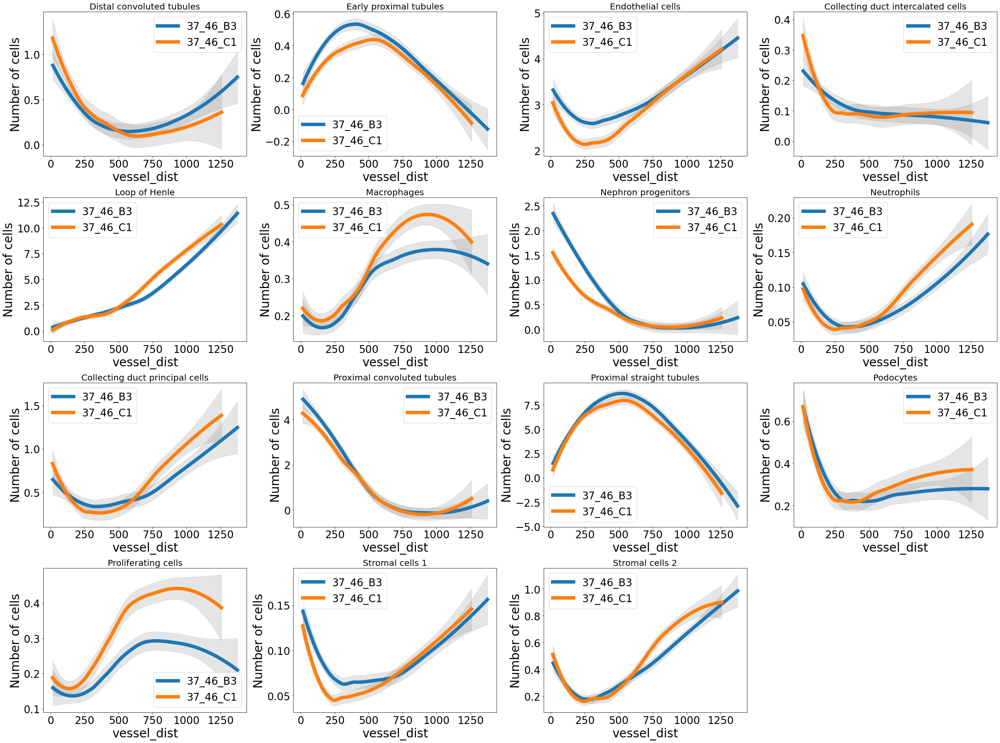

In [23]:
db.pl.expression_along_observation_value(adata, keys=celltypes, x_category='vessel_dist', groupby='id', ylabel="Number of cells")

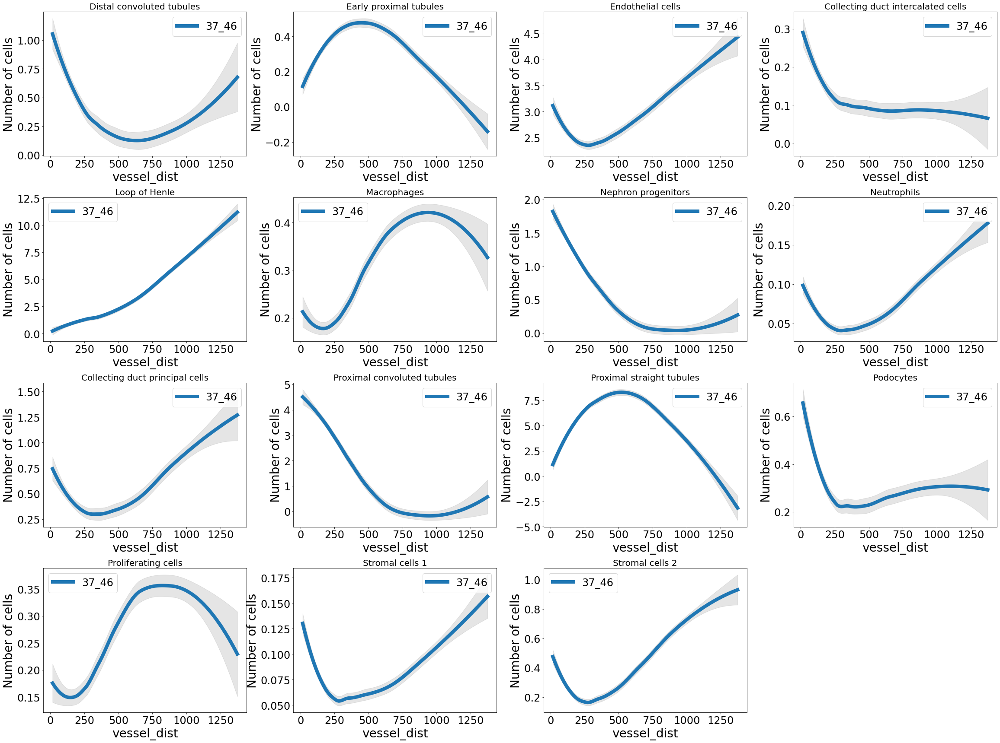

In [82]:
db.pl.expression_along_observation_value(adata, keys=celltypes, x_category='vessel_dist', 
                                         groupby='experiment_id', 
                                         ylabel="Number of cells")

## Plot as percentages

Strategies:
- Percentages in separate dataframe or obsm --> plotting function needs to modified that it accepts this!
- Or add the percentages to obs
- or do it independent from the plotting function! That might be even the easiest option! Then we can also make them all together into one plot or work with stacked barplots etc. Also the grouping into one plot does not make sense! It might be better to show the course of the percentages of all celltypes in one plot of one id and then a second plot for the second id!

### Binning of spots by vessel distance

In [58]:
# extract cell abundances and add vessel distance
df = adata.obsm['q05_cell_abundance_w_sf'].copy()
df['vessel_dist'] = adata.obs['vessel_dist']

# bin vessel distance
df["vessel_dist"] = pd.cut(df["vessel_dist"], 20)

# make vessel distance index
df.index = df['vessel_dist']
df.index.name = "bins"

# calculate mean per vessel distance
df = df.groupby("vessel_dist").transform("max")
df.drop_duplicates(inplace=True) # remove duplicates

# calculate percentages per cell type
totals = df.sum(axis=1)
for c in df.columns:
    df[c] = df[c] / totals * 100

# calculate center of bins, sort by these values and set as index
df["bin_center"] = [elem.left + (elem.right - elem.left)/2 for elem in df.index]
df.sort_values("bin_center", inplace=True)
df.set_index("bin_center", inplace=True)

# get cell type names alone
df.columns = [elem.split("_")[-1] for elem in df.columns]

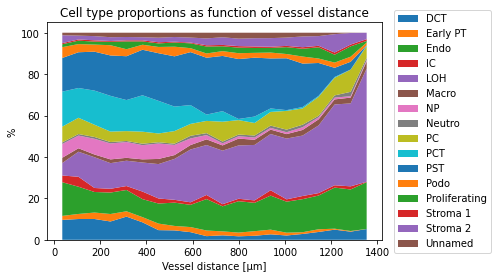

In [59]:
# plotting
plt.stackplot(df.index.values, df.values.T, labels=df.columns.values)

# set plot
plt.title("Cell type proportions as function of vessel distance")
plt.xlabel("Vessel distance [µm]")
plt.ylabel("%")
plt.legend(loc="center left", bbox_to_anchor=(1.02, 0.5))

plt.show()

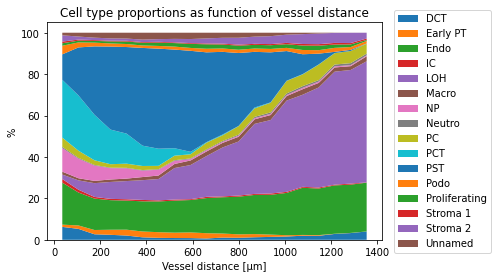

In [48]:
# plotting
plt.stackplot(df.index.values, df.values.T, labels=df.columns.values)

# set plot
plt.title("Cell type proportions as function of vessel distance")
plt.xlabel("Vessel distance [µm]")
plt.ylabel("%")
plt.legend(loc="center left", bbox_to_anchor=(1.02, 0.5))

plt.show()

### Group some cell types as "others" and rename them

In [50]:
# add others category
others_list = ["Early PT", "NP", "Neutro", "Proliferating", "Stroma 1", "Stroma 2", "Unnamed"]
others = df.loc[:, others_list]
df.drop(others, axis='columns', inplace=True)
df["Others"] = others.sum(axis=1)

# get renamed cell types
names = df.columns.values
renamed = [rename_dict[elem] if elem in rename_dict else elem for elem in df.columns]

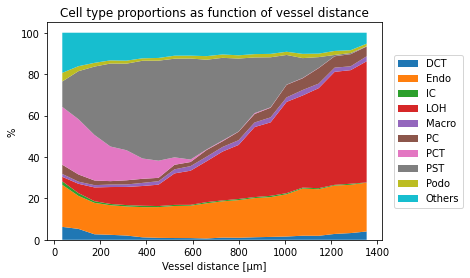

In [51]:
# plotting
plt.stackplot(df.index.values, df.values.T, labels=names)

# set plot
plt.title("Cell type proportions as function of vessel distance")
plt.xlabel("Vessel distance [µm]")
plt.ylabel("%")
plt.legend(loc="center left", bbox_to_anchor=(1.02, 0.5))

#plt.savefig("figures/stackplot_cellprops_vesseldist.pdf", bbox_inches='tight')
plt.show()

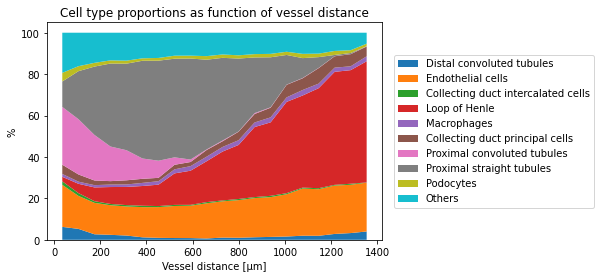

In [52]:
# plotting
plt.stackplot(df.index.values, df.values.T, labels=renamed)

# set plot
plt.title("Cell type proportions as function of vessel distance")
plt.xlabel("Vessel distance [µm]")
plt.ylabel("%")
plt.legend(loc="center left", bbox_to_anchor=(1.02, 0.5))

#plt.savefig("figures/stackplot_cellprops_vesseldist_renamed.pdf", bbox_inches='tight')
plt.show()

# Increase of podocytes close to vessel is not visible since there are also many regions close to vessels that are not glomeruli.

- what about an enrichment score per area?
    - Could be simply the fold change of number of cells of one bin compared to the mean across all bins.

In [75]:
# add others category
others_list = ["Early PT", "NP", "Neutro", "Proliferating", "Stroma 1", "Stroma 2", "Unnamed"]
others = df.loc[:, others_list]
df.drop(others, axis='columns', inplace=True)
df["Others"] = others.sum(axis=1)

# get renamed cell types
names = df.columns.values
renamed = [rename_dict[elem] if elem in rename_dict else elem for elem in df.columns]

In [77]:
# divide each row by the mean of the respective column
df_fold = df.div(df.mean(axis=0))

In [79]:
# reshape
df_fold = df_fold.reset_index().melt(id_vars='bin_center')

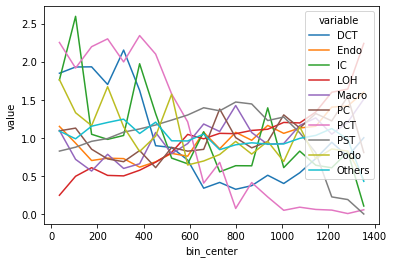

In [80]:
sns.lineplot(data=df_fold, x="bin_center", y="value", hue="variable")

plt.show()

# "Pseudotime" heatmap of genes by vesseldist

#### Strategy
1. Calculate center-of-mass for each gene along vessel distance
2. Order them by center-of-mass
3. Calculate loess regression along vessel distance
4. Plot heatmap

## Center-of-mass calculation

In [95]:
use_raw = False
obs_cat = 'vessel_dist'

if use_raw == True:
    adata_var = adata.raw.var
    adata_X = adata.raw.X
    adata_varnames = adata.raw.var_names
else:
    adata_var = adata.var
    adata_X = adata.X
    adata_varnames = adata.var_names

com = []
position = adata.obs[obs_cat].values
for gene in tqdm(adata_varnames):
    # get expression of gene in all spots
    idx = adata_var.index.get_loc(gene)
    expr = adata_X[:, idx].copy()

    com.append(db.calc.center_of_mass(position, weights=expr))

com_df = pd.DataFrame({
    "center_of_mass": com
}, index=adata_varnames)

100%|██████████| 6010/6010 [00:00<00:00, 21884.74it/s]


### Add to adata

In [96]:
adata.var['center_of_expression'] = com_df['center_of_mass']

Text(0.5, 1.0, 'Gene expression center-of-mass')

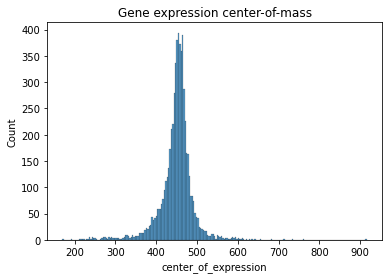

In [97]:
sns.histplot(data=adata.var, x='center_of_expression')
plt.title('Gene expression center-of-mass')

## Filtering

Select only highly variable genes

In [100]:
adata.var['highly_variable'].sum()

457

In [101]:
hvg = adata[:, adata.var['highly_variable']].copy()

## Scaling

In [102]:
scaled = hvg.copy()
sc.pp.scale(scaled)

## Loess regression

In [103]:
df_scaled = db.pl.expression_along_observation_value(scaled, keys=list(hvg.var_names), 
                                                     x_category="vessel_dist", groupby='organ',
                                                     return_data=True, show_progress=True)

100%|██████████| 457/457 [00:25<00:00, 17.78it/s]


In [104]:
df_scaled

x    y_pred       std  conf_lower  \
key           organ                                                    
1110012L19Rik Kidney 0     15.712859  0.251233  0.077375    0.099498   
                     1     29.715043  0.219397  0.068950    0.084184   
                     2     43.717228  0.189007  0.061274    0.068847   
                     3     57.719413  0.160113  0.054411    0.053411   
                     4     71.721598  0.132764  0.048427    0.037798   
...                              ...       ...       ...         ...   
Zfhx3         Kidney 93  1317.916058  0.816083  0.133627    0.554037   
                     94  1331.918243  0.840426  0.140667    0.564574   
                     95  1345.920428  0.864984  0.147937    0.574875   
                     96  1359.922613  0.889758  0.155436    0.584943   
                     97  1373.924798  0.914748  0.163162    0.594783   

                         conf_upper  
key           organ                  
1110012L19Rik Kidney 0     0.402967  
                     1     0.354609  
                     2     0.309167  
                     3     0.266815  
                     4     0.227731  
...                             ...  
Zfhx3         Kidney 93    1.078130  
                     94    1.116277  
                     95    1.155092  
                     96    1.194572  
                     97    1.234714  

[44786 rows x 5 columns]

### Restructure data

In [108]:
expr_scaled = df_scaled.reset_index().pivot(index='key', columns='level_2', values='y_pred')

### Sort by center of expression

In [110]:
genes_sorted = adata.var['center_of_expression'].sort_values(ascending=True).dropna().index
genes_sorted = np.array([elem for elem in genes_sorted if elem in expr_scaled.index])

In [112]:
expr_scaled = expr_scaled.loc[genes_sorted]

### Filter by fraction of cells in which the genes are expressed to only use the top expressed genes

## Heatmap sorted by center of mass

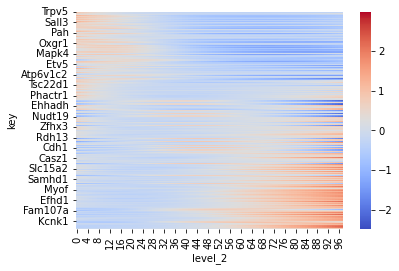

In [116]:
sns.heatmap(expr_scaled, cmap='coolwarm')
plt.show()

## Heatmap clustered hierarchically

/lustre/groups/hpc/meier_lab/.conda/envs/spatial/lib/python3.8/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


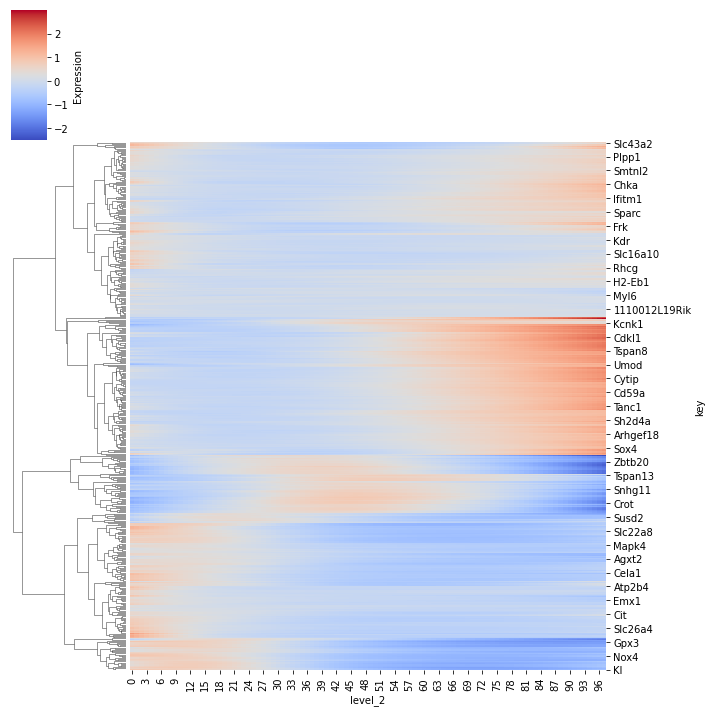

In [119]:
c = sns.clustermap(expr_scaled, 
               #metric="correlation", 
               row_cluster=True, col_cluster=False,
               cmap='coolwarm', 
               #vmin=-maxval, vmax=maxval,
               cbar_kws={
                   'label': 'Expression', 
                   #"ticks":np.linspace(-0.75, 0.75, 7)
               }
              )

#plt.savefig("figures/vesseldist/clustermap_genesxvesseldist_kidney.pdf")
plt.show()

### Clustering

In [41]:
# get dendrogram linkage
Z = c.dendrogram_row.linkage

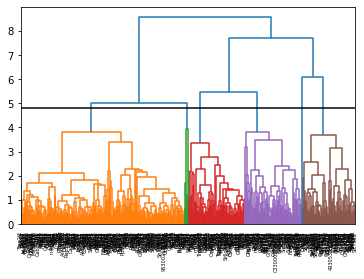

In [42]:
thresh = 4.8
dendrogram(Z,
            orientation='top',
           color_threshold=thresh,
            labels=expr_filtered.index,
            #distance_sort='descending',
           # show_leaf_counts=True
          )
plt.axhline(thresh, c='k')
#plt.savefig("figures/vesseldist/dendrogram_genesxvesseldist_kidney.pdf")
plt.show()

In [43]:
# flatten dendrogram and get gene cluster annotation
clusters = pd.Series(fcluster(Z, 
                              t=thresh, 
                              criterion='distance'), index=expr_filtered.index, name='cluster')

### Note about cluster annotation

Clusters are counted as follows (1,2,3,...):
- `sns.clustermap`: from top to down
- `dendrogram`: from left to right

Good tutorial:
https://joernhees.de/blog/2015/08/26/scipy-hierarchical-clustering-and-dendrogram-tutorial/

## Save expression dataframe and clusters

In [44]:
clusters

key
Slc5a2      4
Fam151a     4
Slc16a14    4
Slc22a8     4
Alpl        4
           ..
Gpc5        1
Frem1       1
Epcam       1
Ptger3      1
Adamtsl1    1
Name: cluster, Length: 513, dtype: int32

In [45]:
# generate output files
savefile = os.path.join(base_dir, "analysis", "vesseldist", "kidney_expression_vesseldist.csv")
clusterfile = os.path.join(base_dir, "analysis", "vesseldist", "kidney_vesseldist_clusters.csv")

In [46]:
# save data
expr_filtered.to_csv(savefile)
clusters.sort_values().to_csv(clusterfile)

### Read data

In [47]:
expr = pd.read_csv(savefile, index_col=0)
clusters = pd.read_csv(clusterfile, index_col=0).iloc[:, 0]

In [48]:
clusters

key
Adamtsl1         1
Fyn              1
Zfhx3            1
Kcnq1            1
Sparc            1
                ..
Cyp2d9           5
Apob             5
4930533I22Rik    5
Slc6a18          5
Kap              6
Name: cluster, Length: 513, dtype: int64

## Plotting of example genes

To show the outcome of the heatmap in detail, we want to plot here example genes surrounding vessel structures. <br>

Most interesting would be the cluster which includes genes with their expression close to a vessel structure: cluster 3

### Calculate upper left spot in pixels

To project the regprops results onto the spatial data it is necessary to get the upper left spot in pixels. In coordinates it is in `adata.uns['spatial']['37_46_C1_dapi']['scalefactors']['upper_left_spot_coord'] = [100,100]`. <br>

It can be calculated from data in `adata.obs` 

In [222]:
keys = list(regprops.keys())

In [271]:
for key in keys:
    print('Processing {}'.format(key))
    entry = adata.obs.query('id == "{}"'.format(key)).iloc[10]

    # extract coordinates
    umcoords = entry[['um_row', 'um_col']].values
    pxcoords = entry[['pixel_row', 'pixel_col']].values

    # extract metadata
    sf = adata.uns['spatial'][key + "_dapi"]['scalefactors']
    ppu = sf['pixel_per_um']
    uls = sf['upper_left_spot_coord']

    # calculate upper left spot
    upper_left_spot_px = np.array([pxcoords[0] - ((umcoords[0]-uls[0]) * ppu), pxcoords[1] - ((umcoords[1]-uls[1]) * ppu)])

    # add result to all entries of this key in the scale factors
    for imkey in [k for k in adata.uns['spatial'].keys() if key in k]:
        adata.uns['spatial'][imkey]['scalefactors']['upper_left_spot_coord_pixel'] = upper_left_spot_px

Processing 37_46_B3
Processing 37_46_C1


## Visualize area around randomly selected vessel

In [285]:
from random import sample, seed

37_46_B3


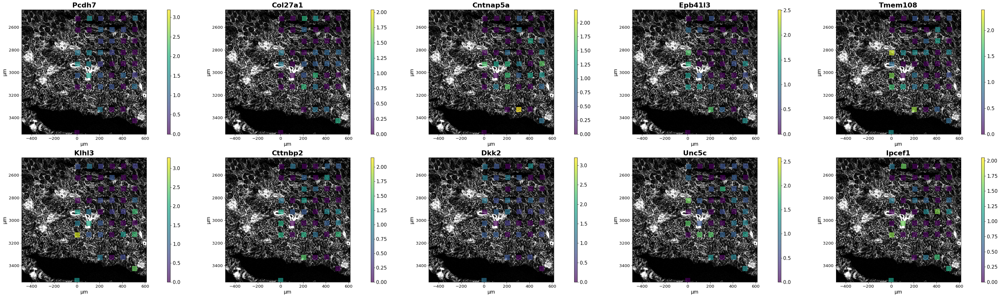

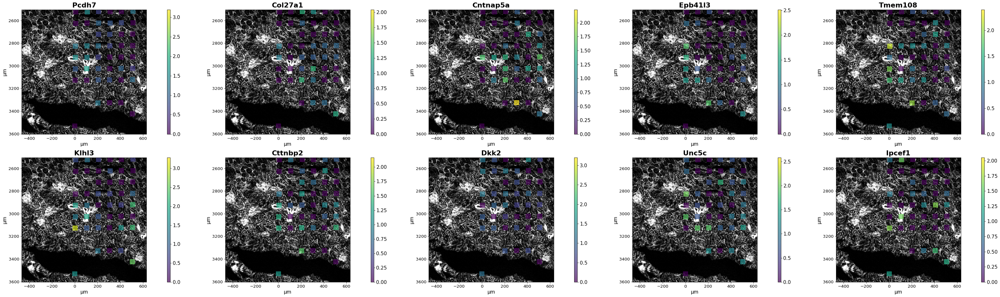

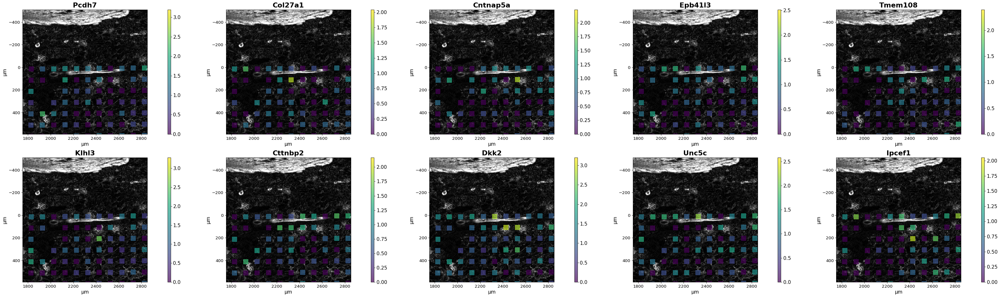

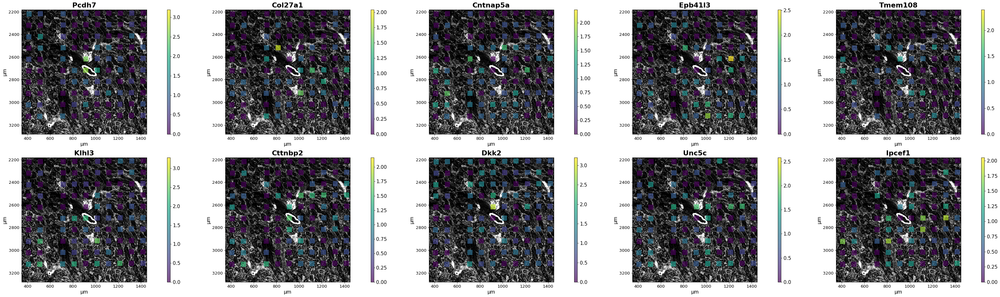

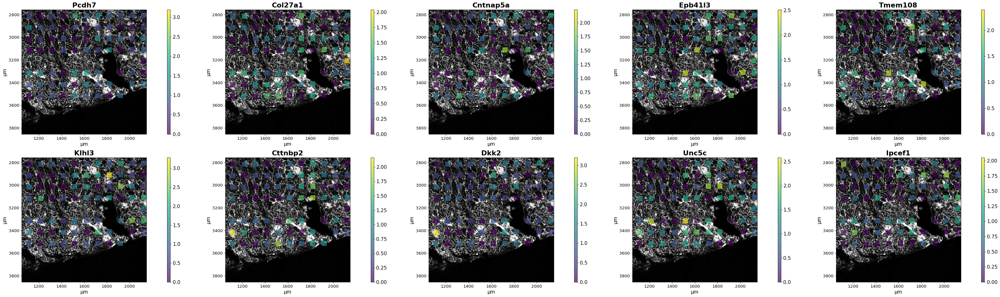

37_46_C1


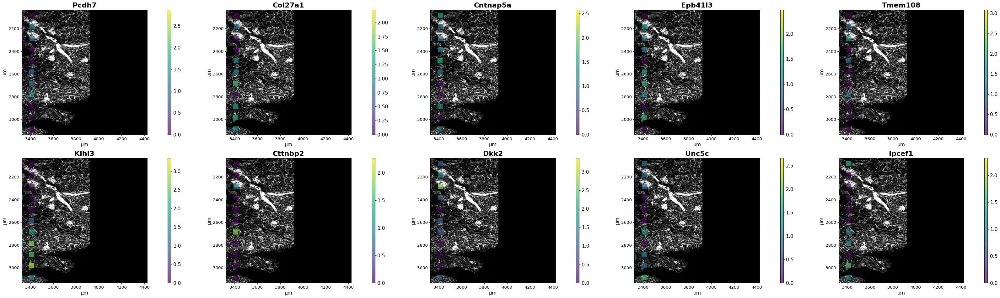

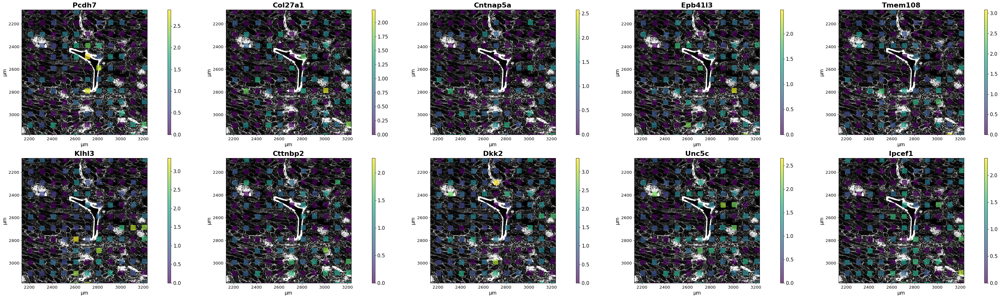

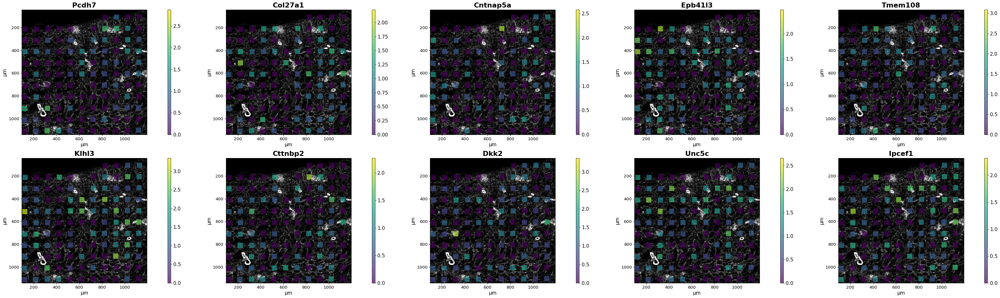

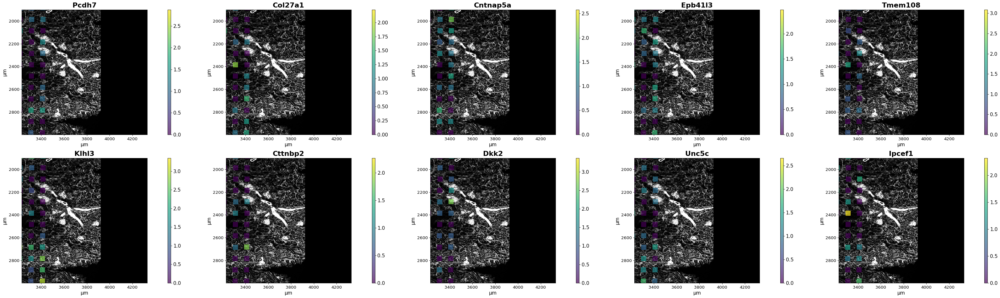

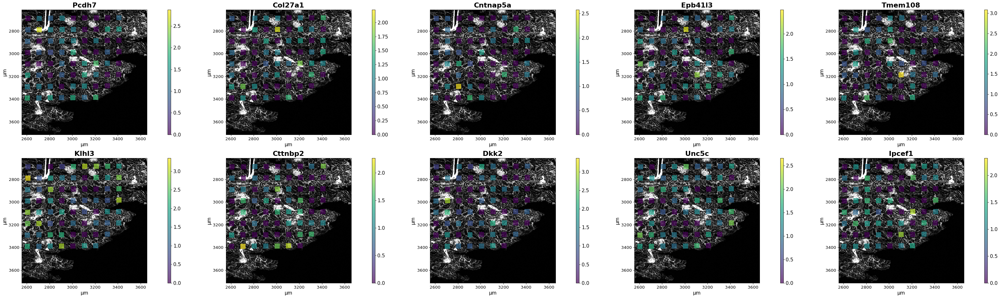

In [334]:
# parameters
cluster = 3
ngenes = 10
selectn = 5
s = 0
frame = 500

# select genes
genes = clusters.loc[clusters == cluster].index[:ngenes]

for key in keys:
    print(key)
    # select binary props
    binprops = regprops[key]['binary']

    # select only vessels
    vesselprops = binprops.loc[binprops.vessel, :]

    # random selection of n vessels
    seed(s)
    indices = vesselprops.index.tolist()
    selected = vesselprops.loc[sample(indices, selectn)]

    # get scalefactors and calculate coordinates of vessel centroid
    sf = adata.uns['spatial'][key + '_dapi']['scalefactors']
    lrsf = sf['tissue_lowres_scalef']
    ppm = sf['pixel_per_um'] * lrsf
    
    # iterate through selections
    for i in range(len(selected)):
        # get coordinates in pixel
        coords_px = selected.iloc[i][['centroid-0', 'centroid-1']].values

        # calculate position of vessel in um
        uls_px = adata.uns['spatial'][key + "_dapi"]['scalefactors']['upper_left_spot_coord_pixel']
        uls_um = adata.uns['spatial'][key + "_dapi"]['scalefactors']['upper_left_spot_coord']
        ppm = adata.uns['spatial'][key + "_dapi"]['scalefactors']['pixel_per_um']
        coords_um = (coords_px - uls_px) / ppm

        # plotting
        db.pl.spatial(adata, keys=genes, groupby='id', groups=key, max_cols=5,
                      xlim=(coords_um[1]-frame, coords_um[1]+frame), ylim=(coords_um[0]-frame, coords_um[0]+frame),
                      image_key='phalloidin', alpha=0.7)

Saving figure to file /home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/vesseldist/cluster3_examplegenes.pdf
Saved.


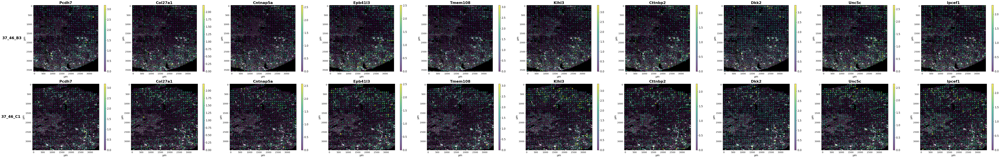

In [331]:
# plotting
db.pl.spatial(adata, keys=genes, groupby='id',
              image_key='phalloidin', alpha=0.7,
              savepath="/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/vesseldist/cluster3_examplegenes.pdf")

In [ ]:
# plotting
db.pl.spatial(adata, keys=genes, groupby='id',
              image_key='phalloidin', alpha=0.7, cmap='magma',
              savepath="/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/vesseldist/cluster3_examplegenes_magma.pdf")

Saving figure to file /home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/vesseldist/cluster3_examplegenes_magma.pdf


# Pattern based clustering

See: `SpatialMouse_13_pattern_clustering.ipynb`

But the conclusion there was rather that this did not give an advantage over the euclidean distance based clustering.

# GO term analysis

## GProfiler

In [72]:
from gprofiler import GProfiler

In [73]:
organism='mmusculus'

edict = {}
for clust in sorted(clusters.unique()):
    # get list of target genes
    target_genes = list(clusters[clusters == clust].index)
    
    # run GO term enrichment
    gp = GProfiler(return_dataframe=True)
    e = gp.profile(organism=organism, query=target_genes, no_evidences=False)
    # calc -log(p_value)
    e['Enrichment score'] = [-np.log10(elem) for elem in e.p_value]
    
    # store result
    edict["Cluster {}".format(clust)] = e

In [74]:
enrichment = pd.concat(edict)

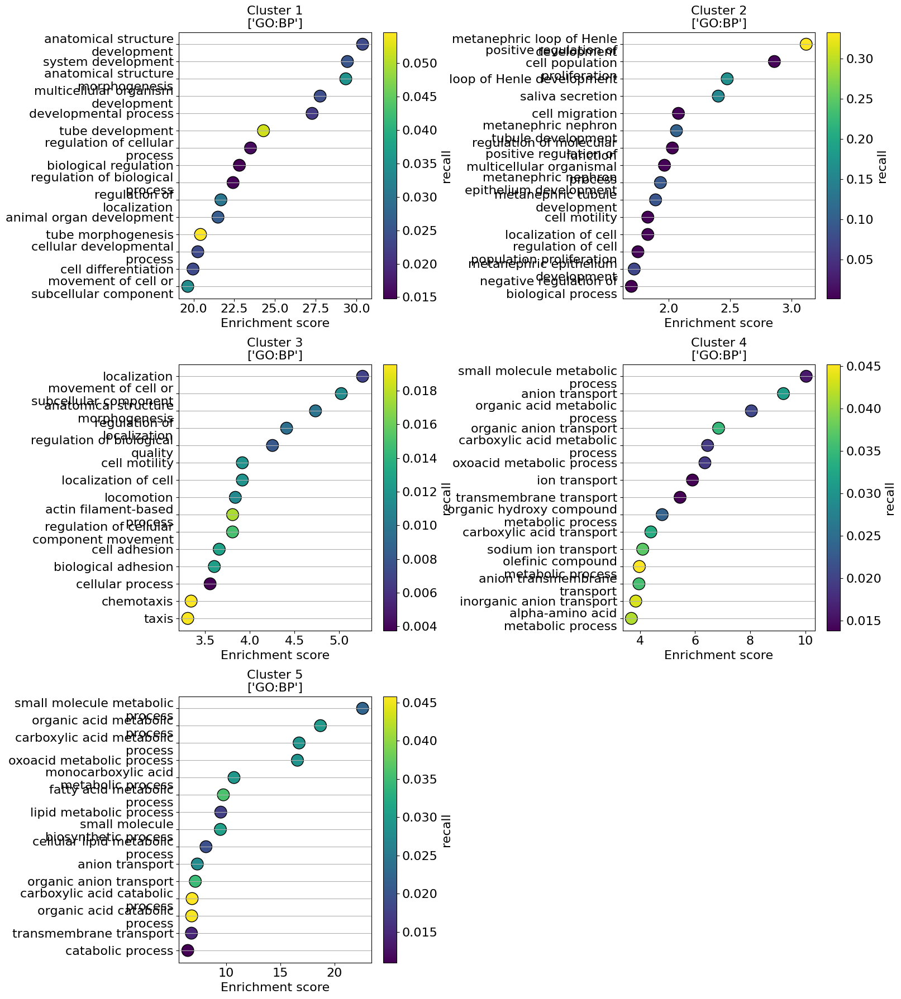

In [75]:
db.pl.go_dotplot(enrichment, libraries=['GO:BP'], max_to_plot=15, color_key='recall', max_cols=2)

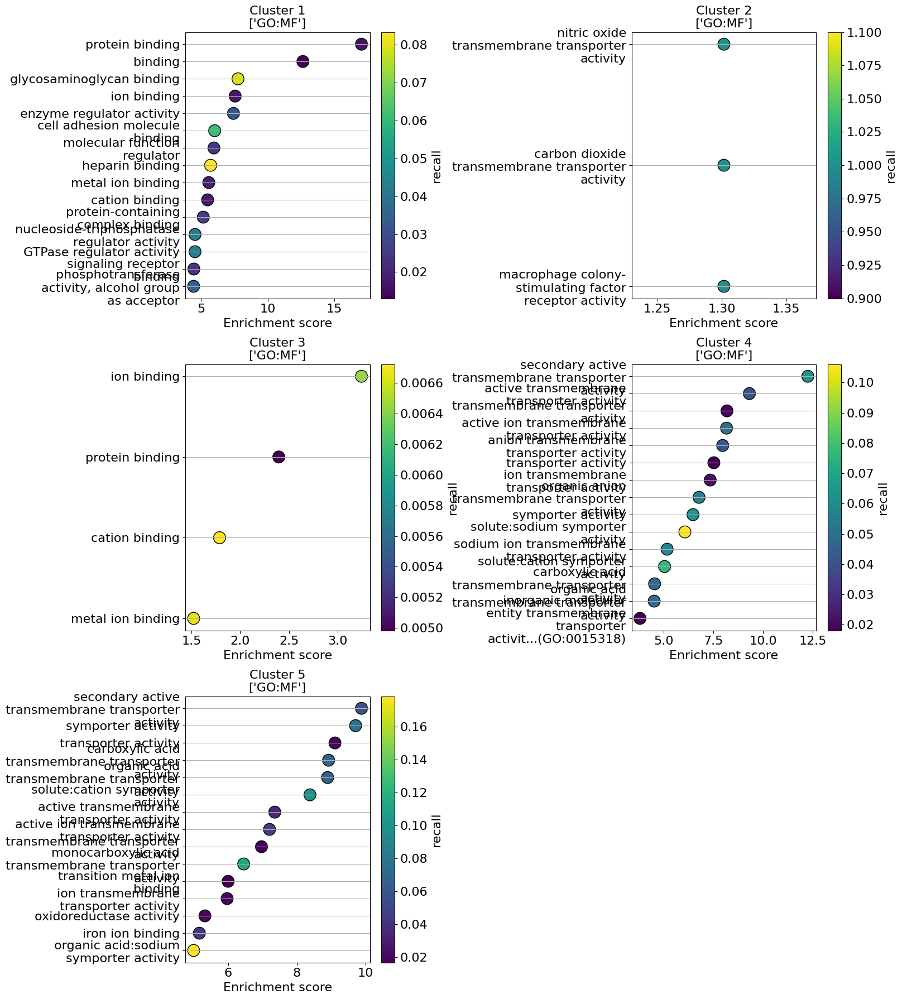

In [77]:
db.pl.go_dotplot(enrichment, libraries=['GO:MF'], max_to_plot=15, color_key='recall', max_cols=2)

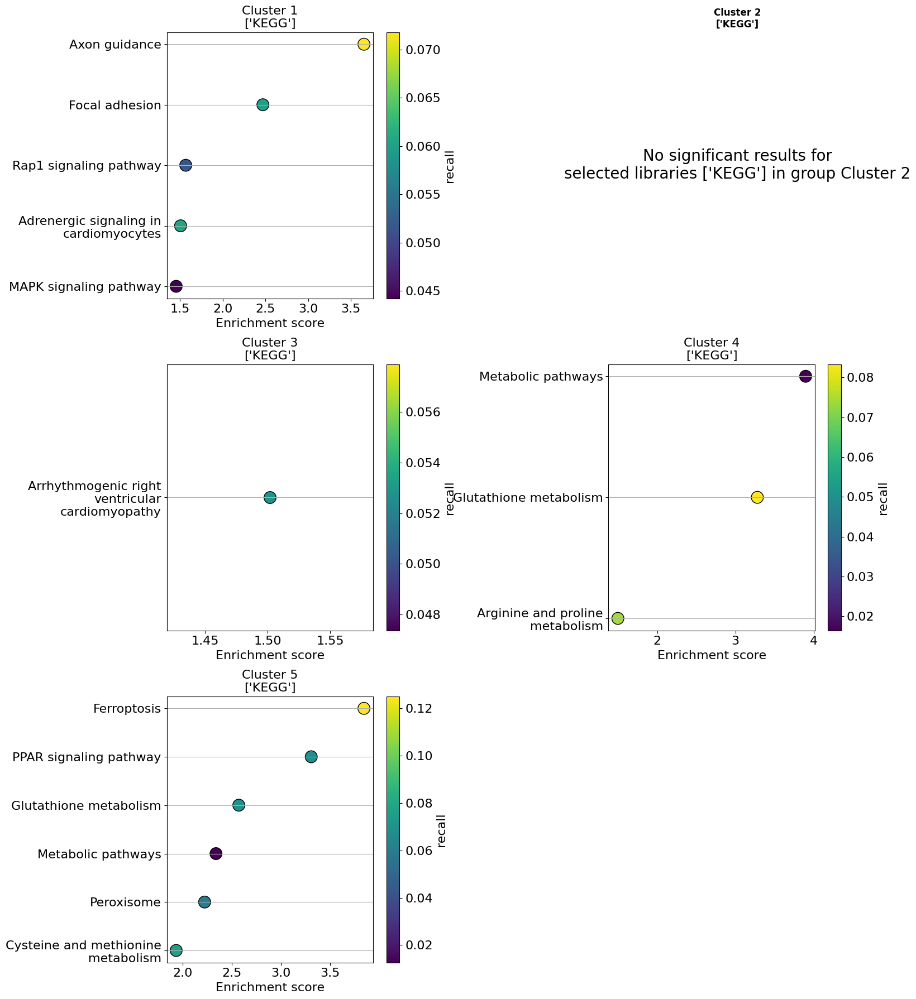

In [78]:
db.pl.go_dotplot(enrichment, libraries=['KEGG'], max_to_plot=15, color_key='recall', max_cols=2)

## StringDB

In [93]:
organism='mmusculus'
min_ngenes = 5

sdb_dict = {}
for clust in sorted(clusters.unique()):
    # get list of target genes
    target_genes = list(clusters[clusters == clust].index)
    
    if len(target_genes) > min_ngenes:
        # run GO term enrichment
        sdb = db.tl.StringDB()
        sdb.call_stringdb_enrichment(genes=target_genes, species='mmusculus')
        e = sdb.result
        # calc -log(p_value)
        e['Enrichment score'] = [-np.log10(elem) for elem in e.p_value]
        e['Gene ratio'] = [a/b for a,b in zip(e['number_of_genes'], e['number_of_genes_in_background'])]
        e.rename(columns={'category': 'source', 
                          'term': 'native', 
                          'description': 'name'}, 
                 inplace=True)

        # store result
        sdb_dict["Cluster {}".format(clust)] = e

sdb_enr = pd.concat(sdb_dict)

## Save enrichment

In [94]:
sdbfile = os.path.join(base_dir, "analysis", "vesseldist", "stringdb_enrichment_clusters.csv")
sdb_enr.to_csv(sdbfile)

## Plotting

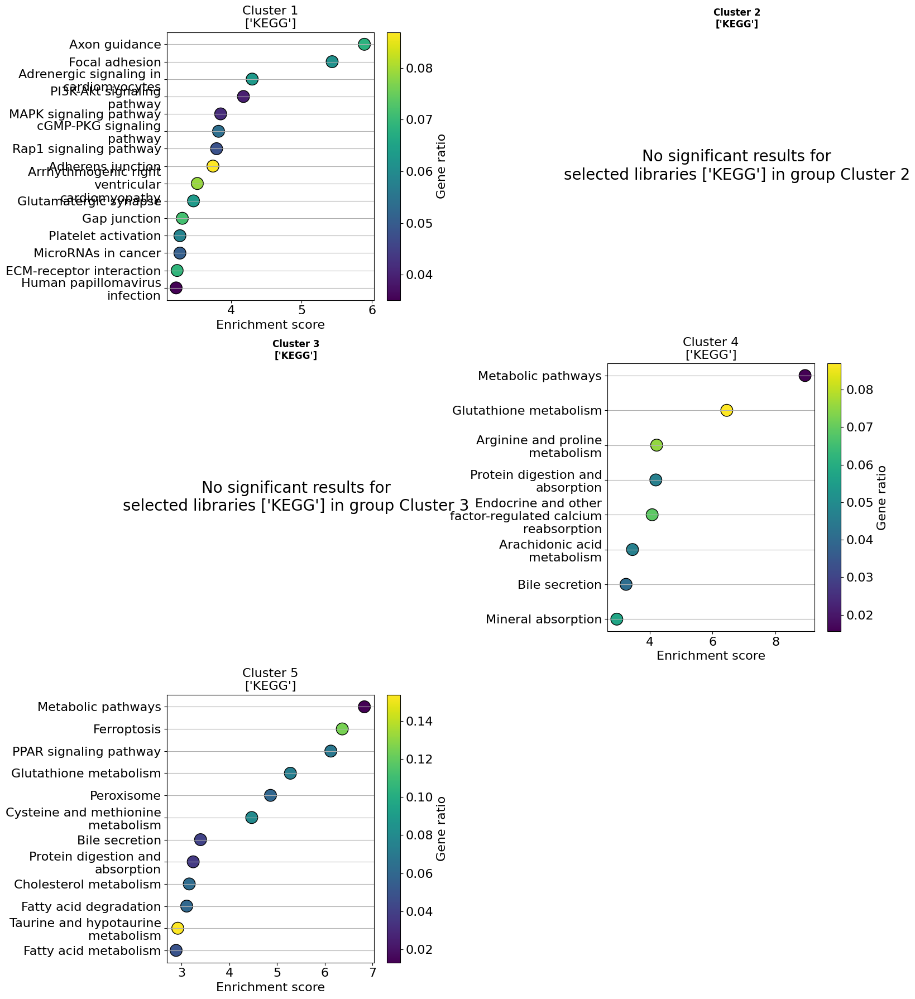

In [95]:
db.pl.go_dotplot(sdb_enr, libraries=['KEGG'], max_to_plot=15, color_key='Gene ratio', max_cols=2)

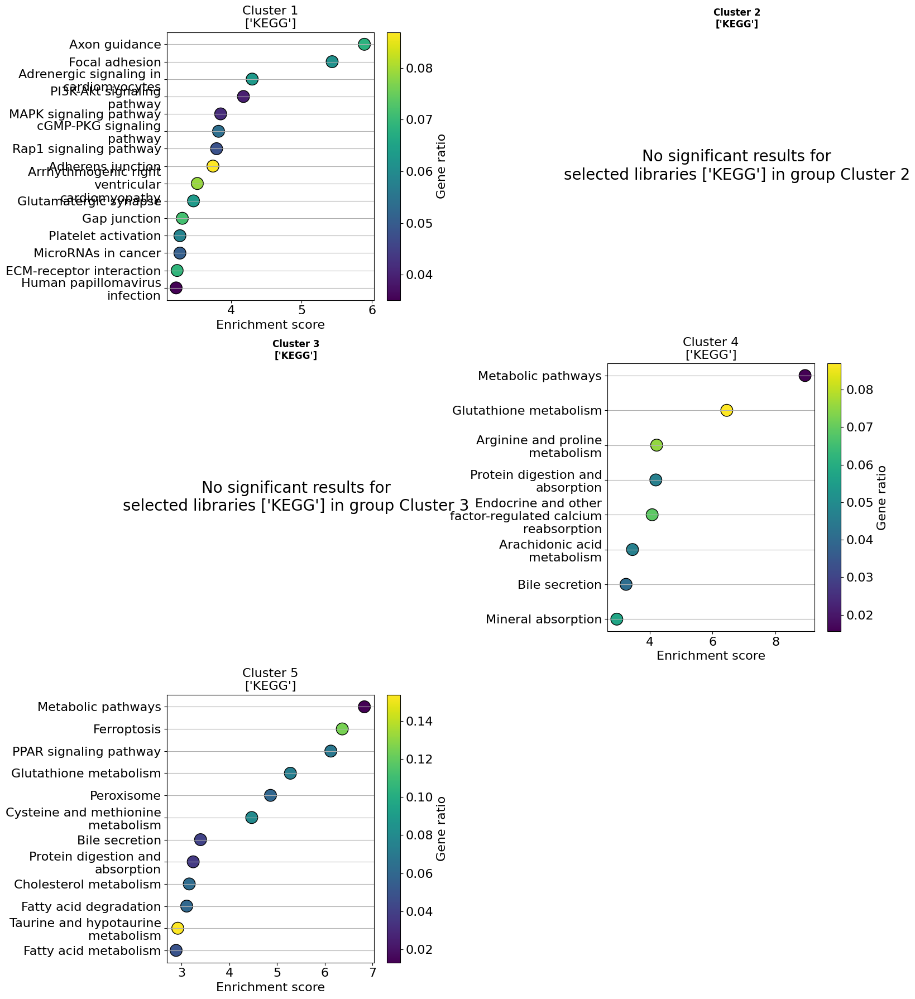

In [96]:
db.pl.go_dotplot(sdb_enr, libraries=['KEGG'], max_to_plot=15, color_key='Gene ratio', max_cols=2)

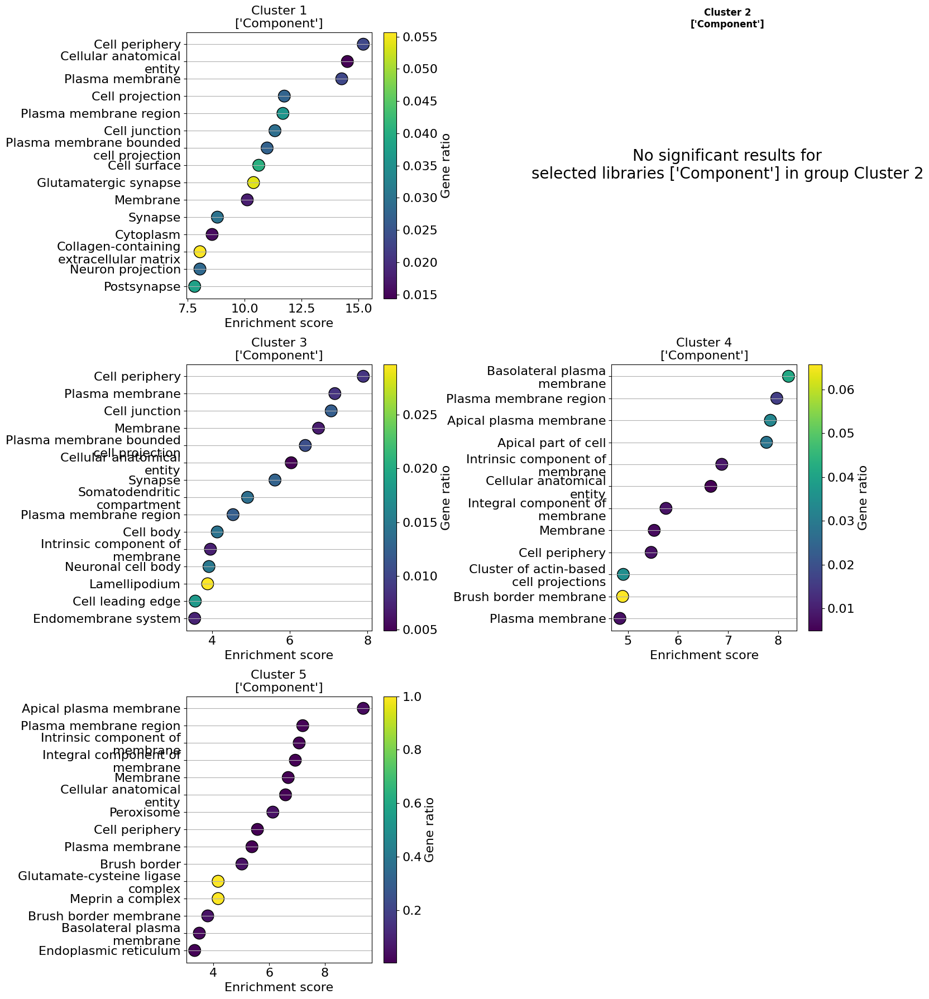

In [97]:
db.pl.go_dotplot(sdb_enr, libraries=['Component'], max_to_plot=15, color_key='Gene ratio', max_cols=2)

Saving figure to file figures/vesseldist/dotplot_stringdb_process.pdf
Saved.


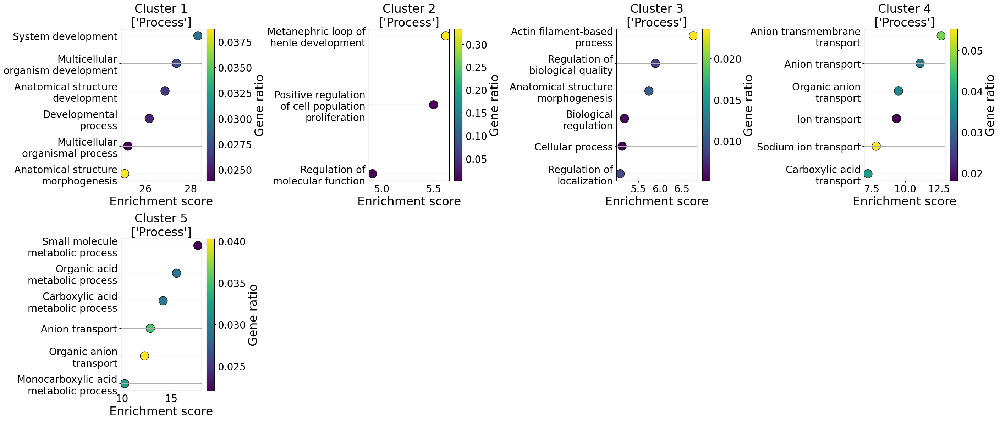

In [102]:
db.pl.go_dotplot(sdb_enr, libraries=['Process'], max_to_plot=6, color_key='Gene ratio', 
                 max_cols=4, figsize=(7,6), max_line_length=20,
                 ytick_label_size=20, xtick_label_size=20, ax_label_size=24, title_size=24, 
                 clb_label_size=24, clb_tick_label_size=20,
                 markersize=300,
                 savepath="figures/vesseldist/dotplot_stringdb_process.pdf"
                )

# Check correlation of genes with binned vessel distances

Since the correlation might take place only inside a certain distance frame we do it for different maximum distances.

In [103]:
from scipy.stats import pearsonr

In [104]:
# define distance threshold
maxdists = [125, 250, 500, 800, np.inf]

corr = {}
for maxdist in maxdists:
    print(maxdist)
    # extract distances
    dists = adata.obs['vessel_dist']
    
    # filter distances
    spotmask = dists <= maxdist

    # # extract gene expression for one gene
    # gid = adata.var_names.get_loc(gene)
    # expr = adata.X[spotmask, gid]

    # calculate correlations for all genes
    c = np.array([pearsonr(dists[spotmask], adata.X[spotmask, i])[0] for i in range(adata.X.shape[1])])
    # transform to Series and add index
    c = pd.Series(c)
    c.index = adata.var_names
    
    # store
    corr[maxdist] = c

corr = pd.DataFrame(corr)

125


/home/hpc/johannes.wirth/miniconda3/envs/spatial/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())


250
500
800
inf


### Filter correlation results

In [105]:
# remove NaNs
corr = corr.dropna()

# filter for minimum correlation
mincorr = 0.5
filtermask = [np.any(np.absolute(c) >= mincorr) for c in corr.values]
corrf = corr.loc[filtermask, :]

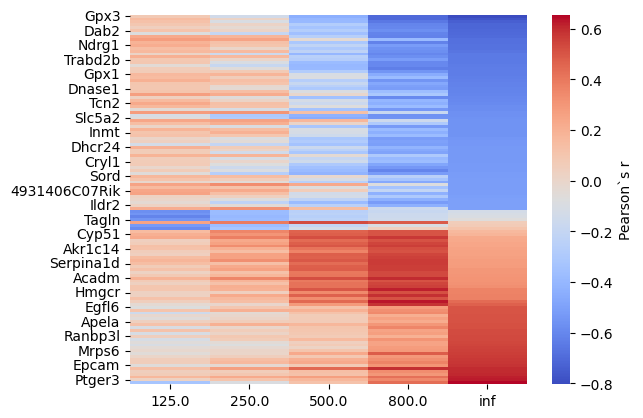

In [106]:
sns.heatmap(corrf.sort_values(np.inf), cmap='coolwarm', 
            cbar_kws={'label': 'Pearson`s r'})
plt.show()

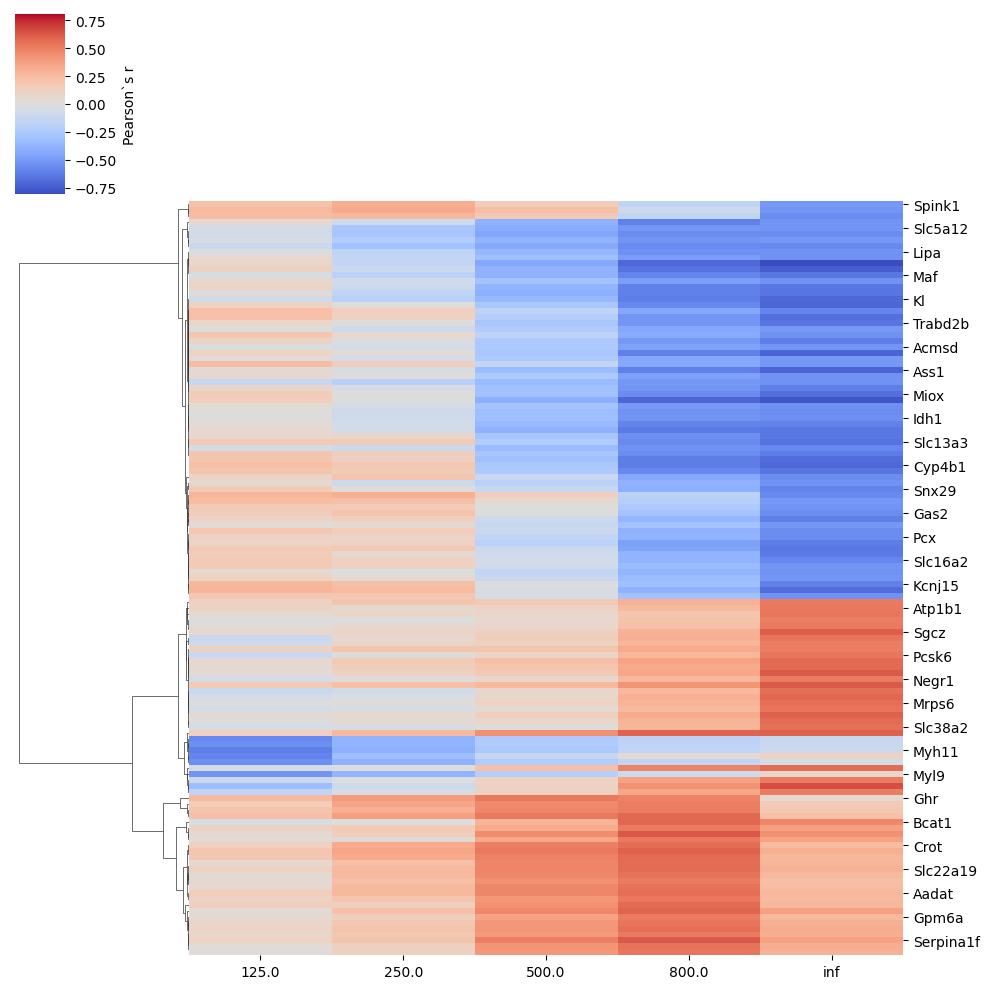

In [107]:
maxval = corrf.abs().max().max()
sns.clustermap(corrf, metric="correlation", row_cluster=True, col_cluster=False,
               cmap='coolwarm', 
               vmin=-maxval, vmax=maxval,
               cbar_kws={
                   'label': 'Pearson`s r', 
                   "ticks":np.linspace(-0.75, 0.75, 7)
               }
              )
#plt.savefig("figures/vesseldist/clustermap_kidneys.pdf")
plt.show()

## Plot top correlating genes per frame

In [108]:
cat = 500
ngenes_to_plot = 3

negcorr = list(corrf.sort_values(cat).head(ngenes_to_plot).index)
poscorr = list(corrf.sort_values(cat).tail(ngenes_to_plot).index)
genes_to_plot = negcorr + poscorr

In [109]:
genes_to_plot

['Slc5a2', 'Gpx3', 'Gatm', 'Napsa', 'Acadm', 'Ghr']

125.0


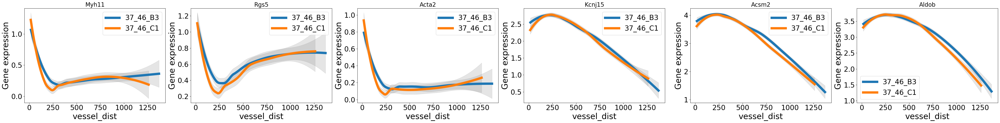

250.0


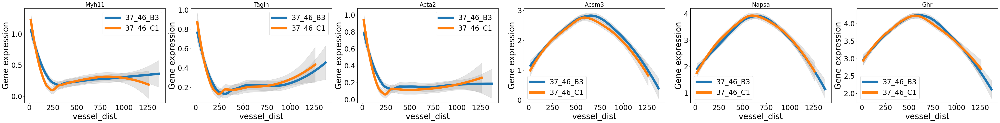

500.0


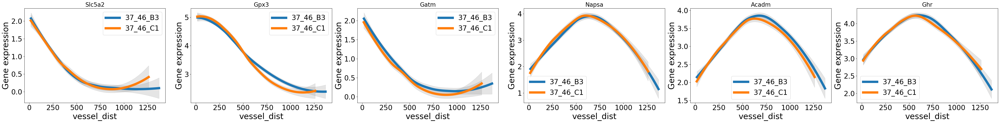

800.0


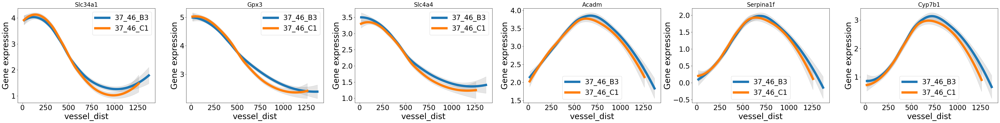

inf


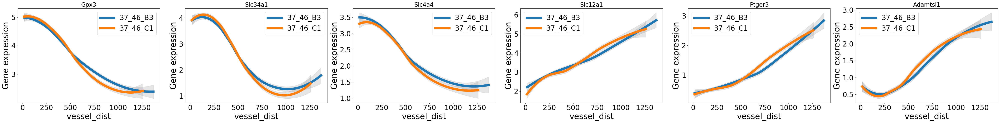

In [110]:
cats = corrf.columns

for cat in cats:
    print(cat)
    
    # get genes
    negcorr = list(corrf.sort_values(cat).head(ngenes_to_plot).index)
    poscorr = list(corrf.sort_values(cat).tail(ngenes_to_plot).index)
    genes_to_plot = negcorr + poscorr
    
    # plotting
    db.pl.expression_along_observation_value(adata, keys=genes_to_plot, x_category='vessel_dist', 
                                             groupby='id', max_cols=int(ngenes_to_plot*2))